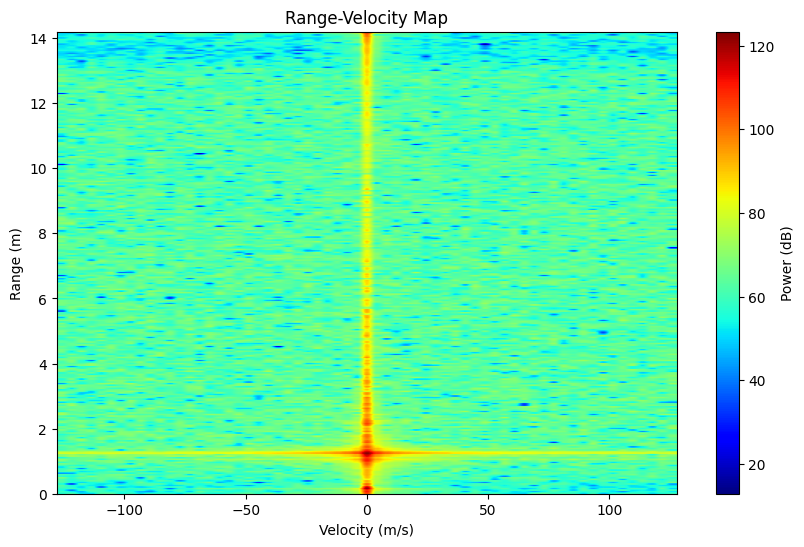

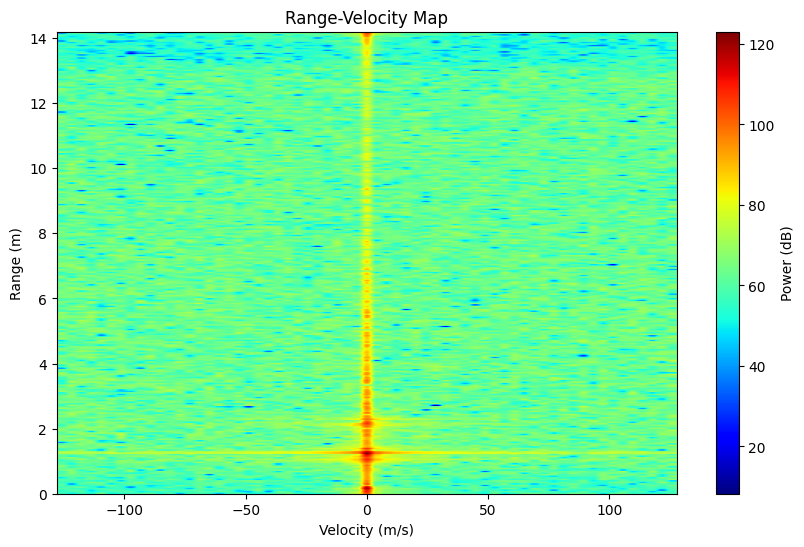

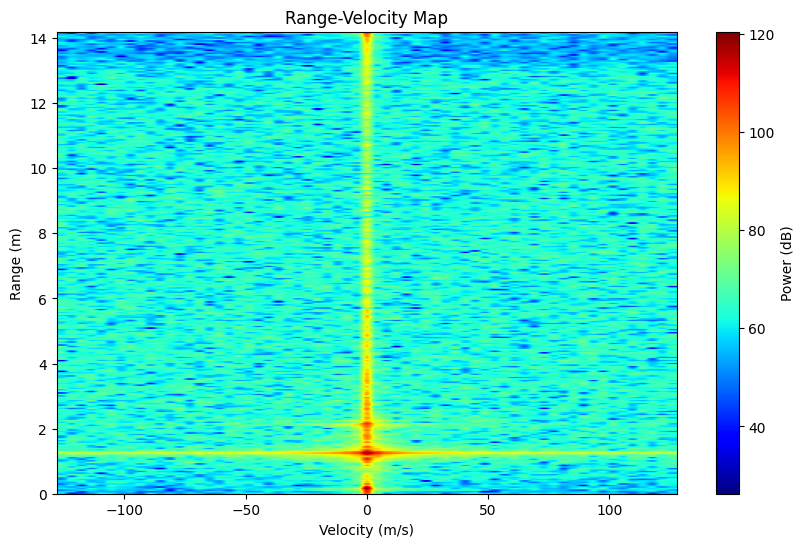

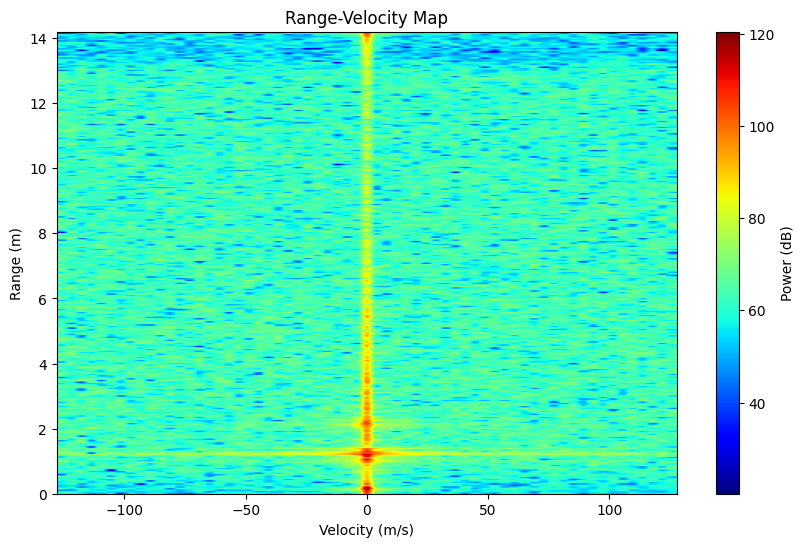

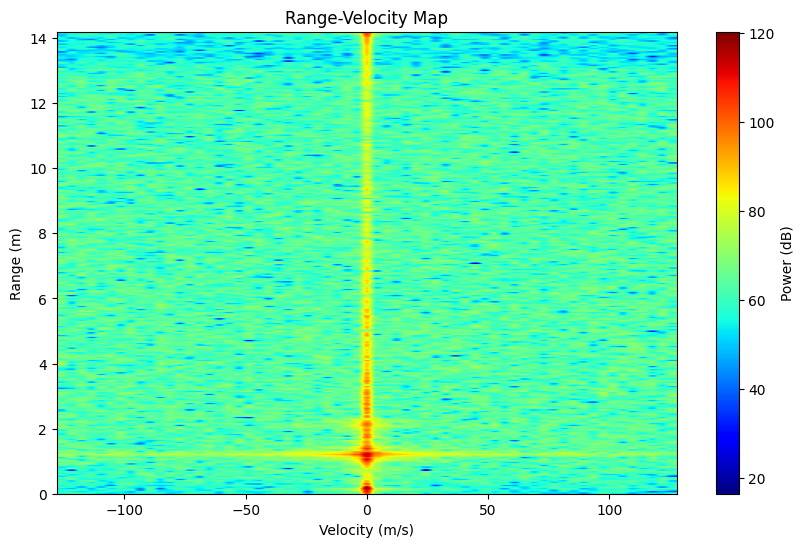

...

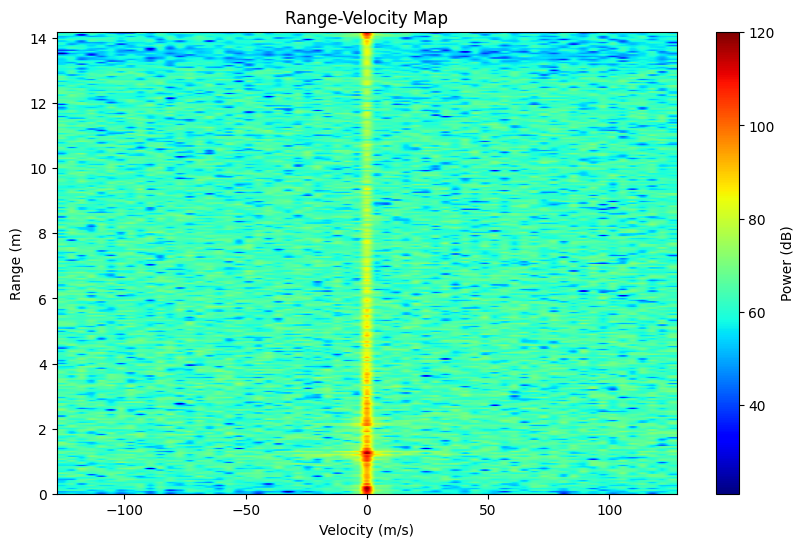

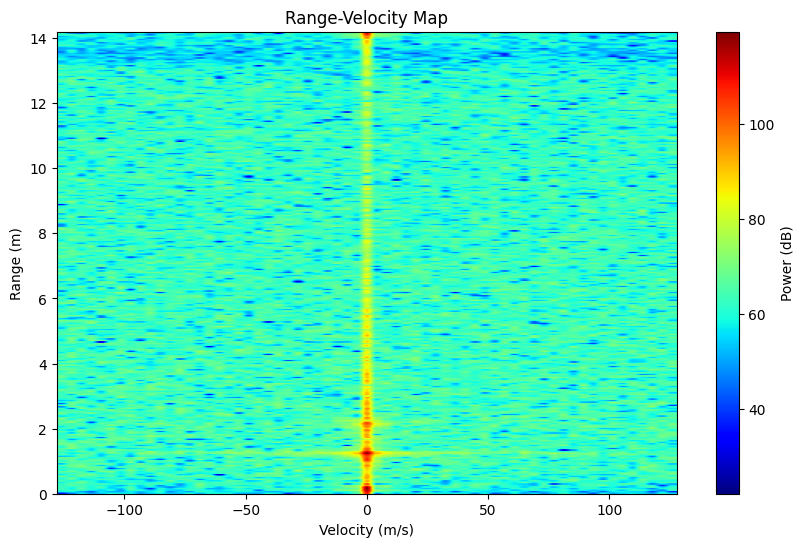

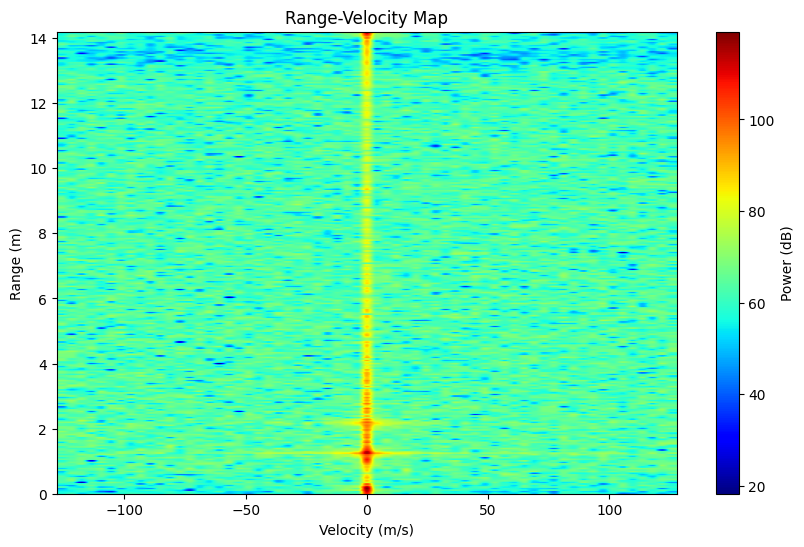

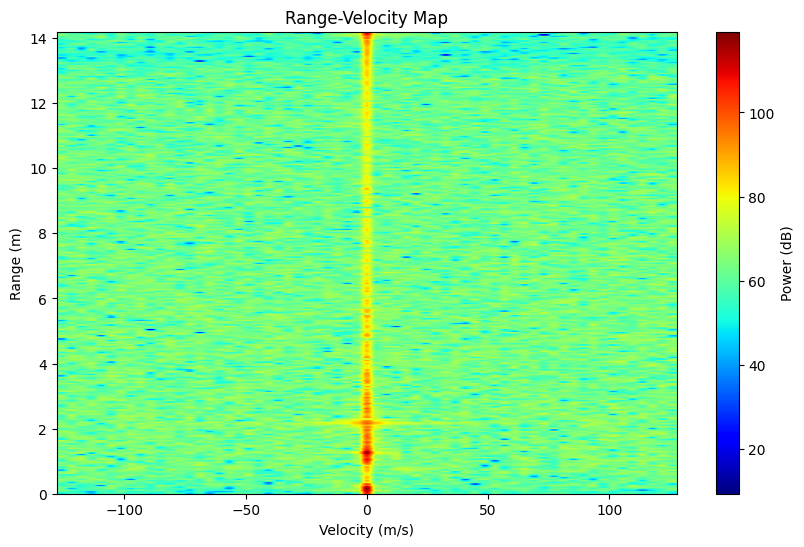

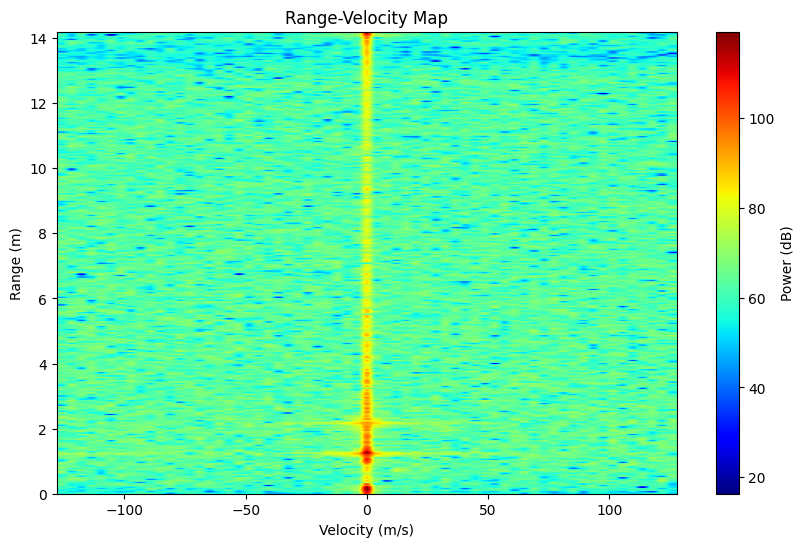

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define file path and parameters
fileFullPath = r'D:\Drone-Swarm-Detection-with-AWR2243\Our data\Radar_Data\IT_Data\DRONE_01\DRONE_01_angle_01\master_0000_data.bin'
numSamplePerChirp = 256  # Number of samples per chirp
numChirpPerLoop = 12  # Number of chirps per loop
numLoops = 128  # Number of loops per frame
numRXPerDevice = 4  # Number of receiving channels per device
numDevices = 4  # Number of devices in the cascade (if needed)

# Radar constants
fc = 77e9  # Radar operating frequency (Hz)
c = 3e8  # Speed of light (m/s)
sweepBandwidth = 3.16e9  # Sweep bandwidth (Hz)
chirpDuration = 40e-6  # Chirp duration (seconds)
Nfft_range = 300  # FFT points for range
Nfft_doppler = 63  # FFT points for Doppler

# Function to read binary radar data
def readBinFile(fileFullPath, frameIdx, numSamplePerChirp, numChirpPerLoop, numLoops, numRXPerDevice):
    Expected_Num_SamplesPerFrame = numSamplePerChirp * numChirpPerLoop * numLoops * numRXPerDevice * 2
    with open(fileFullPath, 'rb') as fp:
        # Move to the desired frame in the file
        fp.seek((frameIdx - 1) * Expected_Num_SamplesPerFrame * 2)
        adcData1 = np.fromfile(fp, dtype=np.uint16, count=Expected_Num_SamplesPerFrame)

    # Convert the 16-bit data to signed integers
    neg = (adcData1 >> 15) == 1  # Check the sign bit
    adcData1 = adcData1.astype(np.int32)
    adcData1[neg] -= 2**16

    # Combine the I and Q channels into complex values
    adcData1 = adcData1[0::2] + 1j * adcData1[1::2]

    # Reshape and permute the data
    adcData1Complex = np.reshape(adcData1, (numRXPerDevice, numSamplePerChirp, numChirpPerLoop, numLoops), order='F')
    adcData1Complex = np.transpose(adcData1Complex, (1, 3, 0, 2))  # Permute dimensions
    return adcData1Complex

# Initialize storage for averaged FFT results


# Process frames
for frameIdx in range(1, 10):
    adcDataComplex = readBinFile(fileFullPath, frameIdx, numSamplePerChirp, numChirpPerLoop, numLoops, numRXPerDevice)
    adcDataComplex_2= readBinFile(fileFullPath_2, frameIdx+1, numSamplePerChirp, numChirpPerLoop, numLoops, numRXPerDevice)
 
    # Collect data from all antennas
    all_antenna_data = []
    for antennaIdx in range(numRXPerDevice):
        chirp_ADC_matrix = adcDataComplex[:, :, antennaIdx, :]
        specific_transmitter_data = np.transpose(chirp_ADC_matrix[:, :, 0])  # Use the first transmitter
        all_antenna_data.append(specific_transmitter_data)

    # Compute mean across antennas
    all_antenna_data = np.array(all_antenna_data)  # Shape: (4, 256, 128)
    mean_values = np.mean(all_antenna_data, axis=0)  # Shape: (256, 128)
    mean_values = np.transpose(mean_values)  # Shape: (128, 256)
    # Perform 2D FFT
    range_fft = np.fft.fft(mean_values, Nfft_range, axis=0)  # FFT across range (ADC samples)
    doppler_fft = np.fft.fftshift(np.fft.fft(range_fft, Nfft_doppler, axis=1), axes=1)  # FFT across Doppler (chirps)
    # #average_array.append(doppler_fft)

    # # Average all Doppler FFTs across frames
    # average_array = np.array(average_array)  # Shape: (128, 300, 63)
    # mean_array = np.mean(average_array, axis=0)  # Shape: (300, 63)

    # Convert to logarithmic scale
    result = 20 * np.log10(np.abs( doppler_fft))

    # Compute range and velocity axes
    range_res = c / (2 * sweepBandwidth)  # Range resolution (meters)
    max_range = range_res * (Nfft_range - 1)  # Maximum measurable range
    range_axis = np.linspace(0, max_range, Nfft_range)

    doppler_res = 1 / (numChirpPerLoop * chirpDuration)  # Doppler resolution (Hz)
    max_doppler = doppler_res * (Nfft_doppler / 2)  # Maximum Doppler shift (Hz)
    doppler_axis = np.linspace(-max_doppler, max_doppler, Nfft_doppler)
    velocity_axis = doppler_axis * (c / (2 * fc))  # Convert Doppler to velocity (m/s)

    # Plot the Range-Velocity Map
    plt.figure(figsize=(10, 6))
    plt.imshow(result, aspect='auto', extent=[velocity_axis[0], velocity_axis[-1], range_axis[0], range_axis[-1]], origin='lower', cmap='jet')
    plt.xlabel('Velocity (m/s)')
    plt.ylabel('Range (m)')
    plt.title('Range-Velocity Map')
    plt.colorbar(label='Power (dB)')
    plt.show()
